In [54]:
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns

In [91]:
pd.options.mode.chained_assignment = None

In [335]:
df = pd.read_csv('sample2.csv', sep=';')
df

,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type,...,children_school,cafe_count_500_price_1000,cafe_avg_price_1000,cafe_avg_price_1500,cafe_avg_price_2000,cafe_avg_price_3000,cafe_avg_price_5000,metro_min_avto,railroad_station_avto_min,public_transport_station_min_walk
0,43.00,27.0,4.0,12.0,1.0,1980.0,2.0,6.0,2.0,Investment,...,10309,0,708.33,768.18,828.57,859.52,947.14,2.590241,6.905893,3.299822
1,34.00,19.0,3.0,12.0,1.0,1980.0,2.0,6.0,2.0,Investment,...,7759,3,846.15,950.00,942.86,858.62,911.31,0.936700,4.679745,0.783160
2,43.00,29.0,2.0,12.0,1.0,1980.0,2.0,6.0,2.0,Investment,...,6207,2,892.86,716.67,770.45,944.87,949.55,2.120999,1.701420,3.945073
3,89.00,50.0,9.0,12.0,1.0,1980.0,2.0,6.0,2.0,Investment,...,13670,0,870.83,902.17,890.00,968.75,1242.11,1.489049,5.271136,1.579164
4,77.00,77.0,4.0,12.0,1.0,1980.0,2.0,6.0,2.0,Investment,...,6748,10,1017.93,1019.76,1017.58,1131.74,1132.66,1.257186,2.156284,0.857764
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38128,52.20,31.8,10.0,12.0,5.0,1973.0,2.0,9.1,2.0,Investment,...,7960,0,926.92,886.36,843.59,940.34,932.19,1.789207,11.649396,0.828790
38129,54.09,30.0,14.0,0.0,1.0,1980.0,2.0,0.0,2.0,OwnerOccupier,...,915,0,1250.00,1250.00,1250.00,1000.00,1485.71,15.839451,21.765343,21.494546
38130,41.08,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,OwnerOccupier,...,6398,11,1207.26,1187.60,1180.19,1167.66,1165.93,1.482746,5.143798,3.912418
38131,34.80,19.8,8.0,9.0,5.0,1977.0,1.0,6.4,2.0,Investment,...,7227,2,744.74,844.23,926.47,969.15,936.71,1.469263,6.164570,1.392524


In [57]:
def choose_columns_with_high_corr(corr_matrix, r):
    high_corr_cols = {}
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if abs(corr_matrix.iloc[i, j]) > r:
                colnames = tuple([corr_matrix.columns[i], corr_matrix.columns[j]])
                high_corr_cols[colnames] = corr_matrix.iloc[i, j]
    return high_corr_cols

In [274]:
corr_matrix = df.corr()

<AxesSubplot:>

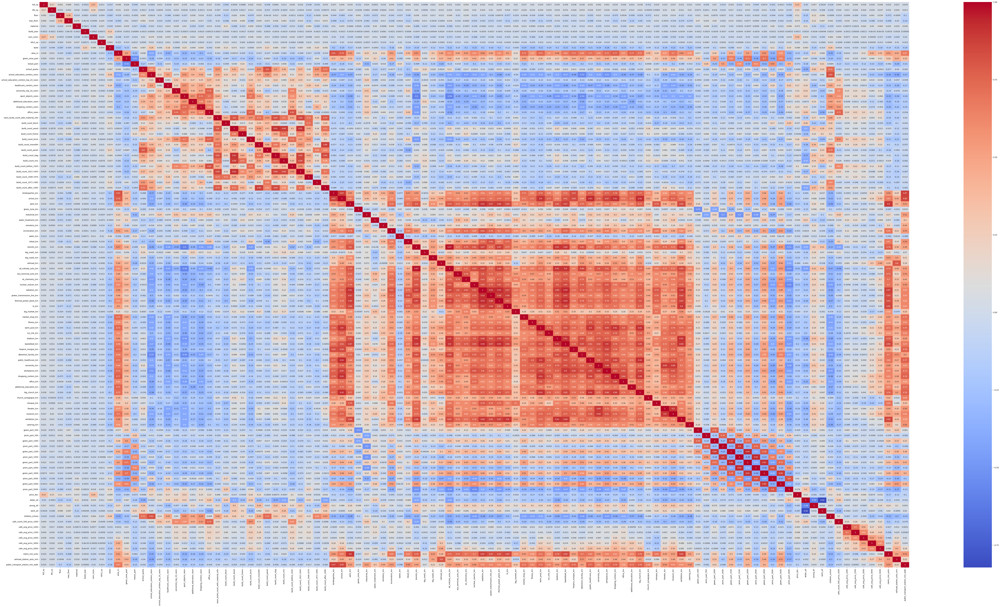

In [7]:
f, ax = plt.subplots(figsize=(105,55))

sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')

## Build

In [336]:
build_cols = df.columns[df.columns.str.contains("build")]

In [337]:
build = df[build_cols]

<AxesSubplot:>

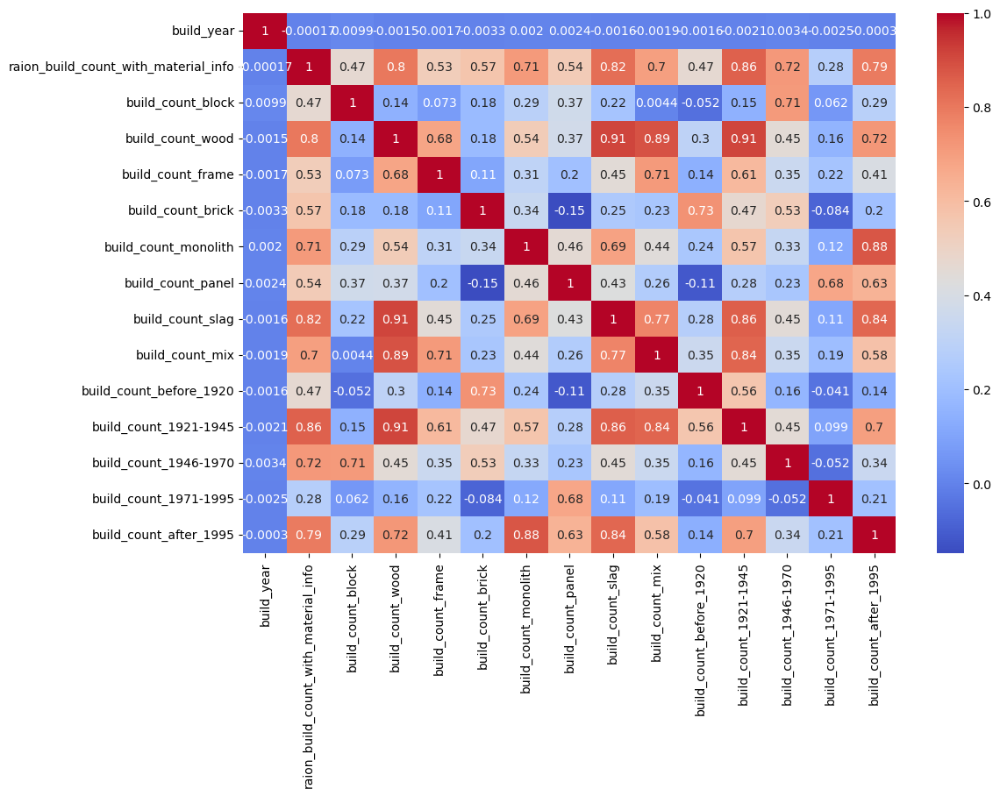

In [96]:
f, ax = plt.subplots(figsize=(12,8))

sns.heatmap(build.corr(), annot=True, cmap='coolwarm')

In [275]:
price = abs(corr_matrix['price_doc'][build_cols])
price.sort_values(ascending=False)

build_count_brick                       0.163712
build_count_monolith                    0.126152
build_count_before_1920                 0.104775
raion_build_count_with_material_info    0.065559
build_count_1946-1970                   0.056392
build_count_after_1995                  0.042479
build_count_1921-1945                   0.041743
build_count_block                       0.037349
build_count_wood                        0.016594
build_count_panel                       0.006427
build_count_frame                       0.004806
build_count_mix                         0.004684
build_year                              0.002334
build_count_1971-1995                   0.001596
build_count_slag                        0.000749
Name: price_doc, dtype: float64

In [338]:
build.columns[build.columns.str.contains('(-|after)')]

C:\Users\User\AppData\Local\Temp\ipykernel_17208\1372521723.py:1: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  build.columns[build.columns.str.contains('(-|after)')]


Index(['build_count_1921-1945', 'build_count_1946-1970',
       'build_count_1971-1995', 'build_count_after_1995'],
      dtype='object')

In [339]:
build.drop(columns=build.columns[build.columns.str.contains('(-|after)')], axis=1, inplace=True)

C:\Users\User\AppData\Local\Temp\ipykernel_17208\1138006479.py:1: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  build.drop(columns=build.columns[build.columns.str.contains('(-|after)')], axis=1, inplace=True)


<AxesSubplot:>

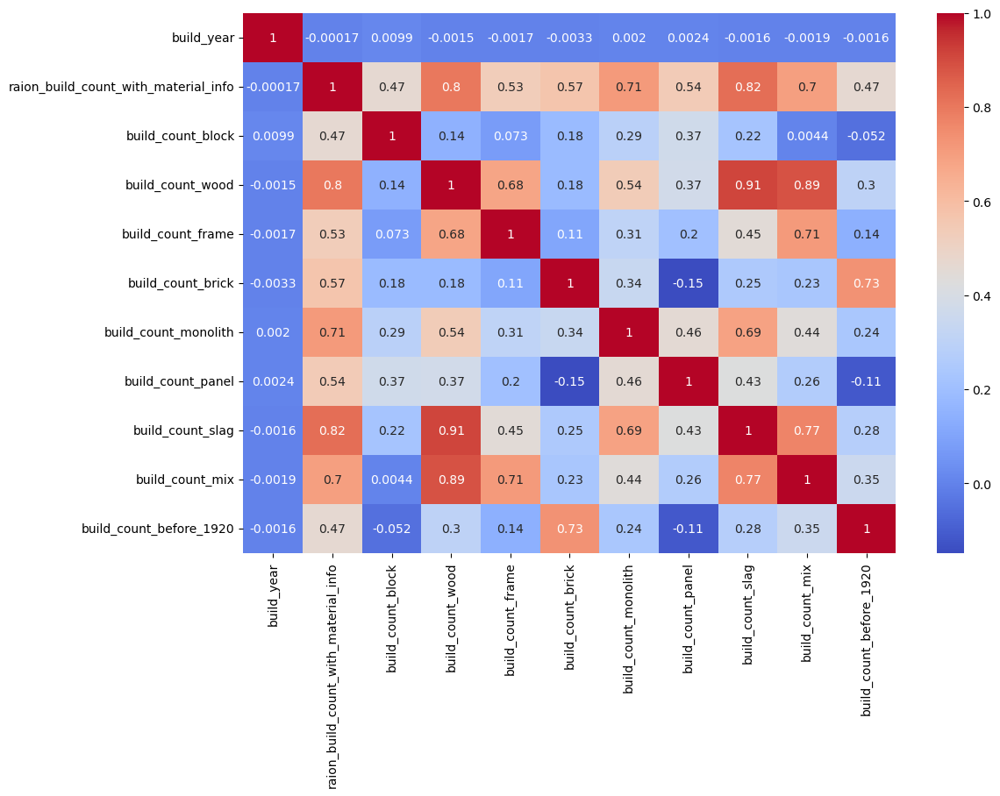

In [100]:
f, ax = plt.subplots(figsize=(12,8))

sns.heatmap(build.corr(), annot=True, cmap='coolwarm')

In [340]:
build.drop("build_count_slag", axis=1,inplace=True)

<AxesSubplot:>

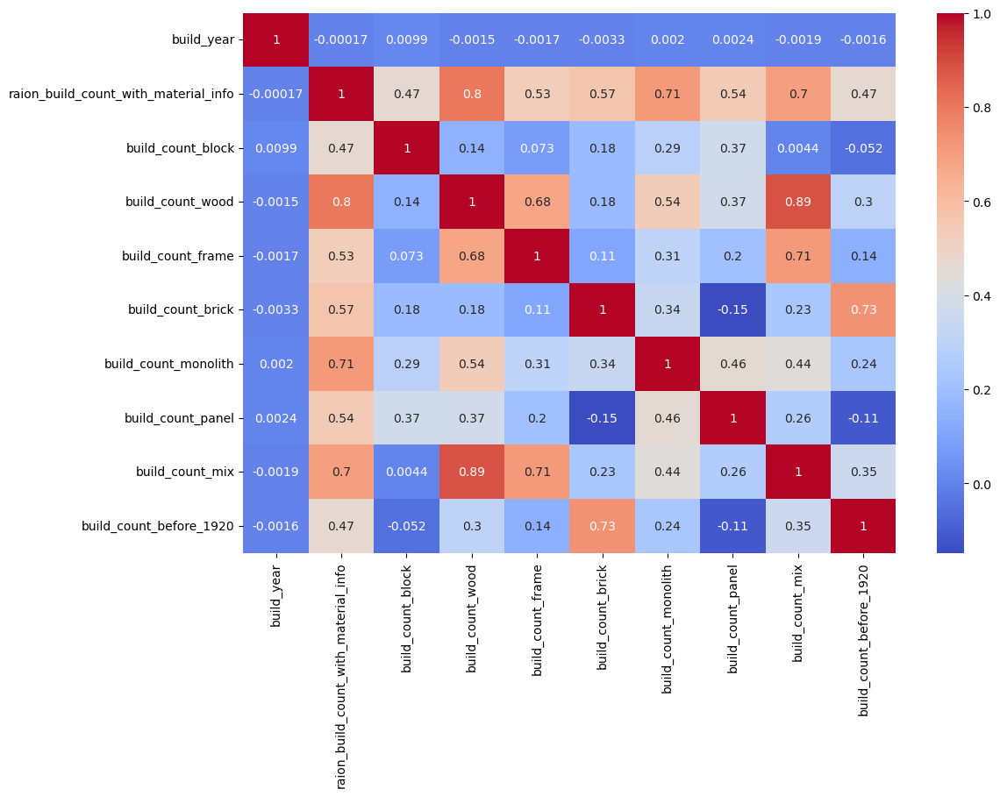

In [80]:
f, ax = plt.subplots(figsize=(12,8))

sns.heatmap(build.corr(), annot=True, cmap='coolwarm')

In [341]:
build.drop(columns=['raion_build_count_with_material_info', 'build_count_mix'], axis=1, inplace=True)

<AxesSubplot:>

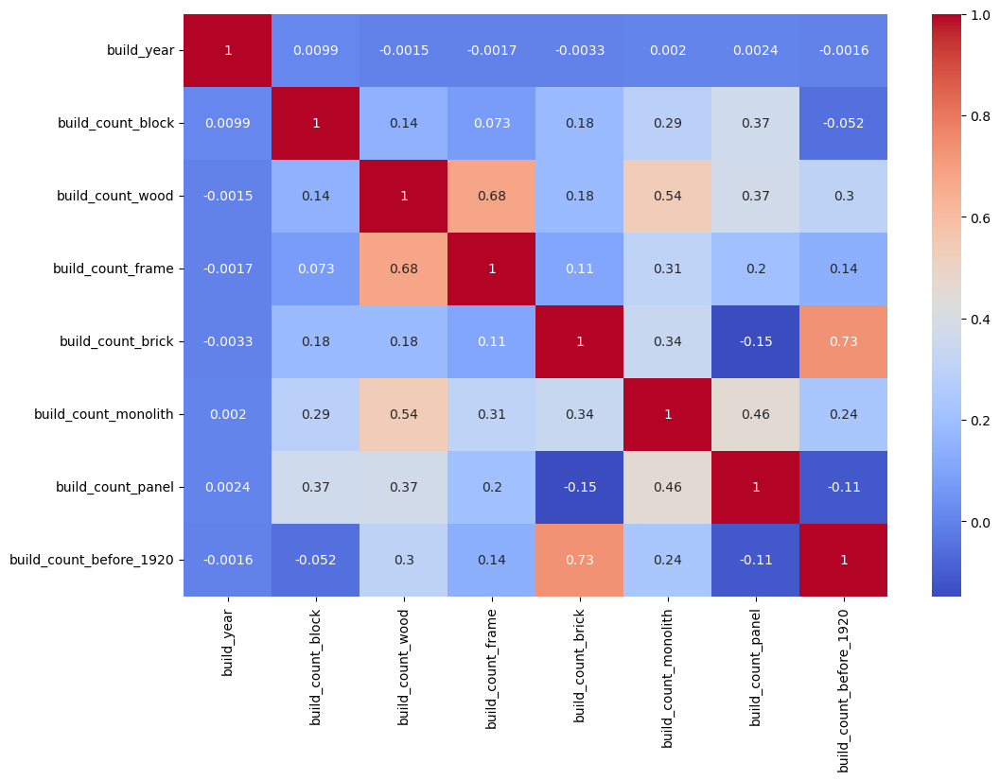

In [82]:
f, ax = plt.subplots(figsize=(12,8))

sns.heatmap(build.corr(), annot=True, cmap='coolwarm')

build_count_frame, build_count_before_1920

In [342]:
build.drop(columns=['build_count_frame', 'build_count_before_1920'], axis=1, inplace=True)

<AxesSubplot:>

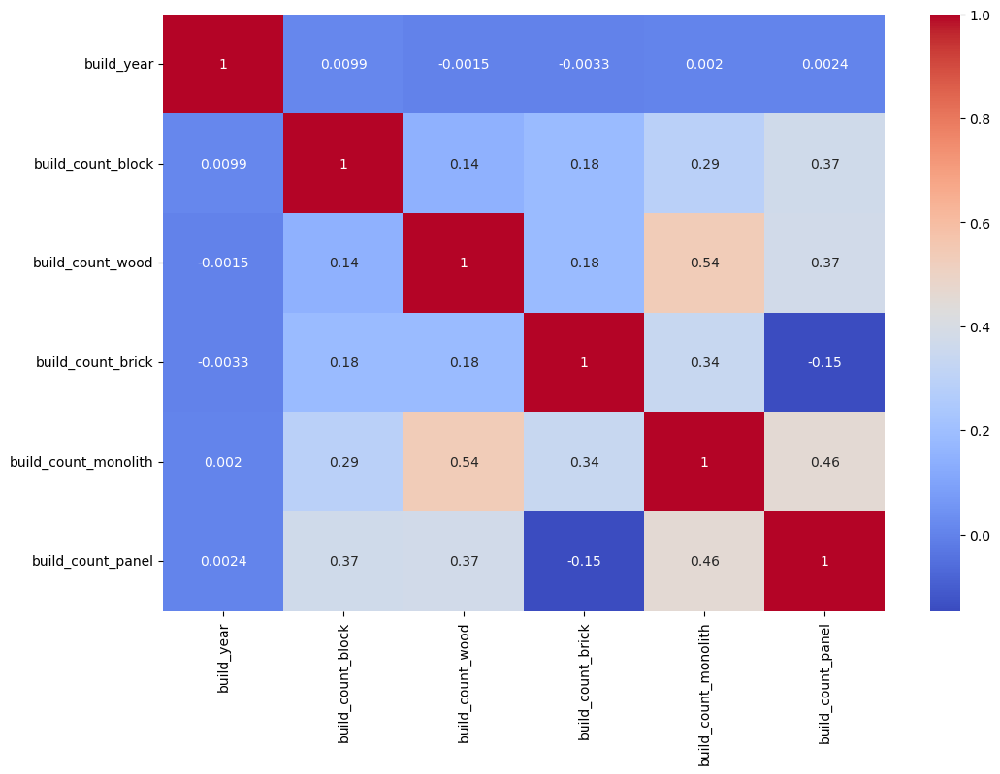

In [84]:
f, ax = plt.subplots(figsize=(12,8))

sns.heatmap(build.corr(), annot=True, cmap='coolwarm')

In [343]:
df.drop(columns=build_cols,axis=1,inplace=True)

In [344]:
df = pd.concat([df, build], axis=1)
df = df.loc[:, ~df.columns.duplicated()]
df

,full_sq,life_sq,floor,max_floor,material,num_room,kitch_sq,state,product_type,sub_area,...,cafe_avg_price_5000,metro_min_avto,railroad_station_avto_min,public_transport_station_min_walk,build_year,build_count_block,build_count_wood,build_count_brick,build_count_monolith,build_count_panel
0,43.00,27.0,4.0,12.0,1.0,2.0,6.0,2.0,Investment,Bibirevo,...,947.14,2.590241,6.905893,3.299822,1980.0,25.0,0.0,0.0,2.0,184.0
1,34.00,19.0,3.0,12.0,1.0,2.0,6.0,2.0,Investment,Nagatinskij Zaton,...,911.31,0.936700,4.679745,0.783160,1980.0,83.0,1.0,67.0,4.0,90.0
2,43.00,29.0,2.0,12.0,1.0,2.0,6.0,2.0,Investment,Tekstil'shhiki,...,949.55,2.120999,1.701420,3.945073,1980.0,59.0,0.0,206.0,4.0,60.0
3,89.00,50.0,9.0,12.0,1.0,2.0,6.0,2.0,Investment,Mitino,...,1242.11,1.489049,5.271136,1.579164,1980.0,9.0,51.0,124.0,50.0,201.0
4,77.00,77.0,4.0,12.0,1.0,2.0,6.0,2.0,Investment,Basmannoe,...,1132.66,1.257186,2.156284,0.857764,1980.0,48.0,0.0,643.0,16.0,35.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38128,52.20,31.8,10.0,12.0,5.0,2.0,9.1,2.0,Investment,Kon'kovo,...,932.19,1.789207,11.649396,0.828790,1973.0,44.0,0.0,7.0,3.0,260.0
38129,54.09,30.0,14.0,0.0,1.0,2.0,0.0,2.0,OwnerOccupier,Poselenie Desjonovskoe,...,1485.71,15.839451,21.765343,21.494546,1980.0,43.0,1.0,68.0,6.0,92.0
38130,41.08,1.0,12.0,1.0,1.0,1.0,1.0,1.0,OwnerOccupier,Tverskoe,...,1165.93,1.482746,5.143798,3.912418,1.0,19.0,27.0,529.0,25.0,41.0
38131,34.80,19.8,8.0,9.0,5.0,1.0,6.4,2.0,Investment,Orehovo-Borisovo Juzhnoe,...,936.71,1.469263,6.164570,1.392524,1977.0,28.0,0.0,0.0,3.0,164.0


In [353]:
corr_matrix = df.corr()

<AxesSubplot:>

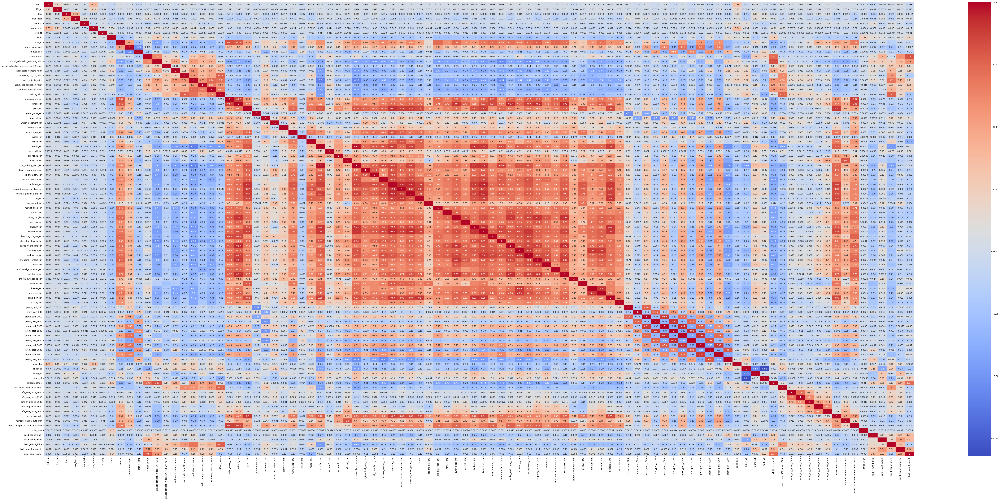

In [107]:
f, ax = plt.subplots(figsize=(95,40))

sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')

In [109]:
choose_columns_with_high_corr(corr_matrix, 0.90)

{('zd_vokzaly_avto_km', 'kremlin_km'): 0.9657739323384571,
 ('radiation_km', 'park_km'): 0.9103649524855937,
 ('power_transmission_line_km', 'radiation_km'): 0.9251836607660232,
 ('thermal_power_plant_km', 'radiation_km'): 0.9347167048147037,
 ('swim_pool_km', 'school_km'): 0.902654141569172,
 ('stadium_km', 'kremlin_km'): 0.9058245460422197,
 ('stadium_km', 'zd_vokzaly_avto_km'): 0.90528615283079,
 ('basketball_km', 'zd_vokzaly_avto_km'): 0.9048094776592642,
 ('basketball_km', 'radiation_km'): 0.9387123057189608,
 ('basketball_km', 'thermal_power_plant_km'): 0.9260760314467597,
 ('basketball_km', 'stadium_km'): 0.909157620815499,
 ('public_healthcare_km', 'school_km'): 0.9300741413415982,
 ('shopping_centers_km', 'school_km'): 0.9116099495026733,
 ('shopping_centers_km', 'swim_pool_km'): 0.9071782241413211,
 ('big_church_km', 'school_km'): 0.9242663713839956,
 ('big_church_km', 'swim_pool_km'): 0.910602811855252,
 ('big_church_km', 'public_healthcare_km'): 0.915978619785369,
 ('museum

In [345]:
ecology_cols = df.columns[df.columns.str.contains("""(green|prom|indust|park|water|incineration|oil|nuclear|radiation_km|
                                  power|thermal|ts|power_transmission)""")]

C:\Users\User\AppData\Local\Temp\ipykernel_17208\2845312009.py:1: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  ecology_cols = df.columns[df.columns.str.contains("""(green|prom|indust|park|water|incineration|oil|nuclear|radiation_km|


In [347]:
ecology = df[ecology_cols]
ecology

,green_zone_part,indust_part,sport_objects_raion,park_km,green_zone_km,industrial_km,water_treatment_km,incineration_km,water_km,oil_chemistry_km,...,green_part_1000,prom_part_1000,green_part_1500,prom_part_1500,green_part_2000,prom_part_2000,green_part_3000,prom_part_3000,green_part_5000,prom_part_5000
0,0.189727,0.000070,7,2.158587,0.600973,1.080934,23.683460,3.633334,0.992631,18.152338,...,7.36,0.00,14.27,6.92,11.77,15.97,11.98,13.55,13.09,13.31
1,0.372602,0.049637,6,0.550690,0.065321,0.966479,1.317476,8.648587,0.698081,9.034642,...,26.66,0.07,21.53,7.71,22.37,19.25,18.07,27.32,10.26,27.47
2,0.112560,0.118537,5,0.374848,0.453172,0.939275,4.912660,11.996480,0.468265,5.777394,...,4.99,0.29,9.92,6.73,12.99,12.75,12.14,26.46,13.69,21.58
3,0.194703,0.069753,17,0.078090,0.106125,0.451173,15.623710,14.317640,1.200336,27.667863,...,19.25,10.35,28.38,6.57,32.29,5.73,20.79,3.57,14.18,3.89
4,0.015234,0.037316,25,0.258289,0.236214,0.392871,10.683540,11.903910,0.820294,6.515857,...,3.34,8.29,4.12,4.83,4.53,5.02,5.06,8.62,8.38,10.92
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38128,0.127002,0.135650,11,2.985011,0.199909,0.624466,8.841655,7.347121,0.219356,16.967654,...,19.49,11.81,30.47,14.58,34.77,13.03,41.79,8.38,30.34,4.66
38129,0.349935,0.011654,0,9.684197,0.991824,1.351922,9.211348,18.367510,0.215268,30.671952,...,0.00,0.00,8.47,0.05,18.54,0.10,40.25,0.43,39.40,1.32
38130,0.065444,0.000078,29,0.284300,0.189089,2.640803,10.378040,12.180740,0.524839,8.750185,...,7.51,0.00,5.70,0.00,6.05,0.00,6.96,0.99,6.80,5.73
38131,0.075790,0.100456,7,2.950264,0.766444,0.521349,5.611768,5.667783,1.394677,6.997322,...,0.91,13.33,4.80,10.56,10.24,6.16,21.96,2.74,17.69,2.63


<AxesSubplot:>

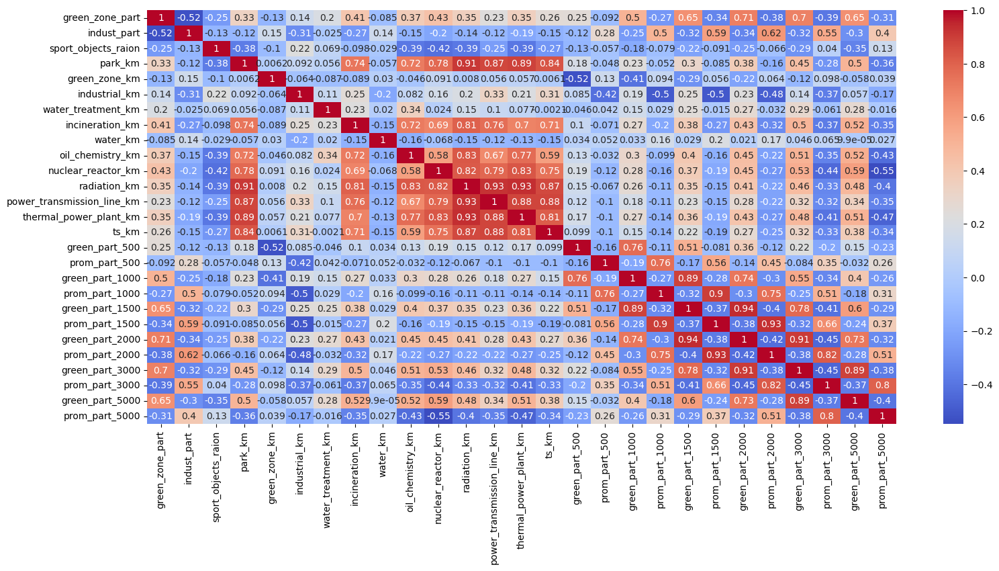

In [348]:
f, ax = plt.subplots(figsize=(18,8))

sns.heatmap(ecology.corr(), annot=True, cmap='coolwarm')

In [349]:
drop_cols = ecology.columns[ecology.columns.str.contains('(green|prom)_part')]

C:\Users\User\AppData\Local\Temp\ipykernel_17208\3364362067.py:1: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  drop_cols = ecology.columns[ecology.columns.str.contains('(green|prom)_part')]


In [350]:
ecology = ecology.drop(columns=drop_cols, axis=1)

<AxesSubplot:>

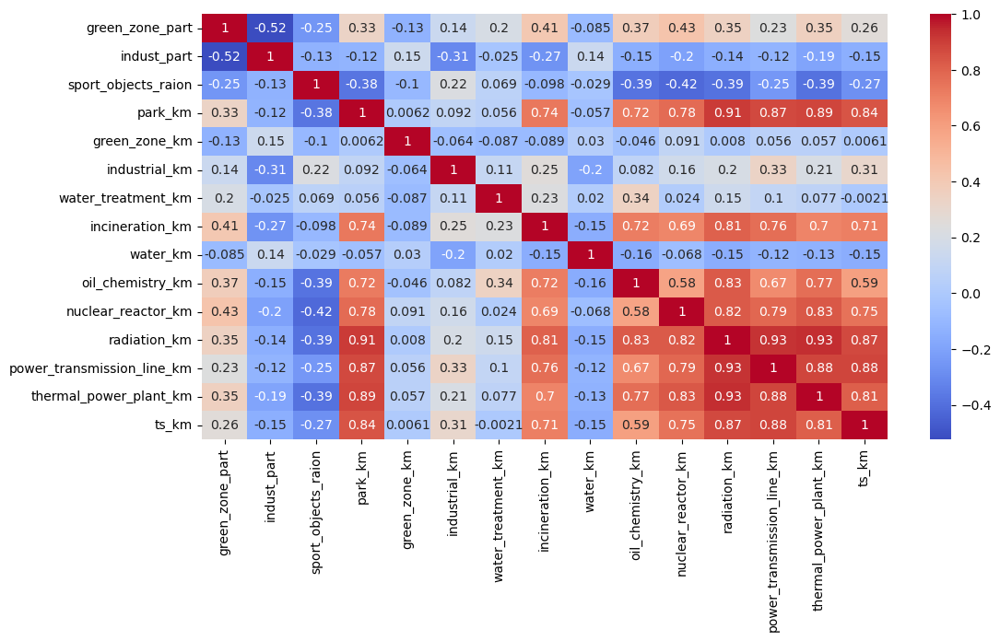

In [351]:
f, ax = plt.subplots(figsize=(12,6))

sns.heatmap(ecology.corr(), annot=True, cmap='coolwarm')

In [354]:
price = abs(corr_matrix['price_doc'][ecology_cols])
price.sort_values(ascending=False)

nuclear_reactor_km            0.227237
sport_objects_raion           0.225260
thermal_power_plant_km        0.185723
radiation_km                  0.169887
park_km                       0.168908
ts_km                         0.142928
green_part_5000               0.142062
power_transmission_line_km    0.136314
green_part_3000               0.123739
oil_chemistry_km              0.107373
green_part_2000               0.095136
green_zone_part               0.084283
prom_part_5000                0.077618
indust_part                   0.072879
green_part_1500               0.070980
prom_part_1500                0.059932
green_zone_km                 0.055136
incineration_km               0.054716
green_part_1000               0.053028
prom_part_1000                0.050399
water_treatment_km            0.048836
green_part_500                0.048789
industrial_km                 0.045557
prom_part_2000                0.044518
water_km                      0.024005
prom_part_3000           

In [355]:
ecology['bad_ecology_factor_km'] = (ecology['incineration_km'] + ecology['oil_chemistry_km'] + ecology['nuclear_reactor_km'] + \
                                 ecology['radiation_km'] + ecology['thermal_power_plant_km'] + ecology['ts_km'] + \
                                   ecology['power_transmission_line_km']) / 7

In [356]:
ecology.drop(columns=['incineration_km', 'oil_chemistry_km', 'radiation_km', 'thermal_power_plant_km', 'ts_km',
                      'nuclear_reactor_km', 'power_transmission_line_km'], axis=1,inplace=True)

<AxesSubplot:>

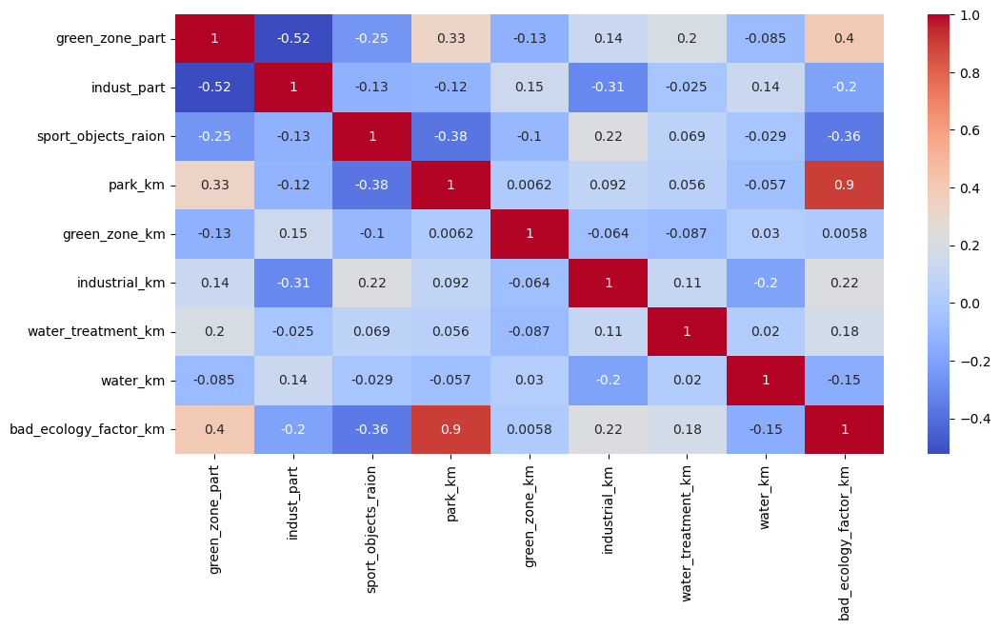

In [357]:
f, ax = plt.subplots(figsize=(12,6))

sns.heatmap(ecology.corr(), annot=True, cmap='coolwarm')

In [358]:
y = df['price_doc']
x = ecology['bad_ecology_factor_km']
z = df['park_km']

In [359]:
data = pd.concat([x,y, z], axis=1)
data

,bad_ecology_factor_km,price_doc,park_km
0,5.699856,5850000.00,2.158587
1,4.184109,6000000.00,0.550690
2,4.985647,5700000.00,0.374848
3,10.197961,13100000.00,0.078090
4,5.651297,16331452.00,0.258289
...,...,...,...
38128,6.249382,7118500.41,2.985011
38129,17.797019,7118500.41,9.684197
38130,5.999268,7118500.41,0.284300
38131,4.887081,7118500.41,2.950264


In [360]:
data.corr()['price_doc']

bad_ecology_factor_km   -0.160739
price_doc                1.000000
park_km                 -0.168908
Name: price_doc, dtype: float64

park km is better than bad_ecology_factor_km

In [361]:
ecology.drop('bad_ecology_factor_km', axis=1, inplace=True)

<AxesSubplot:>

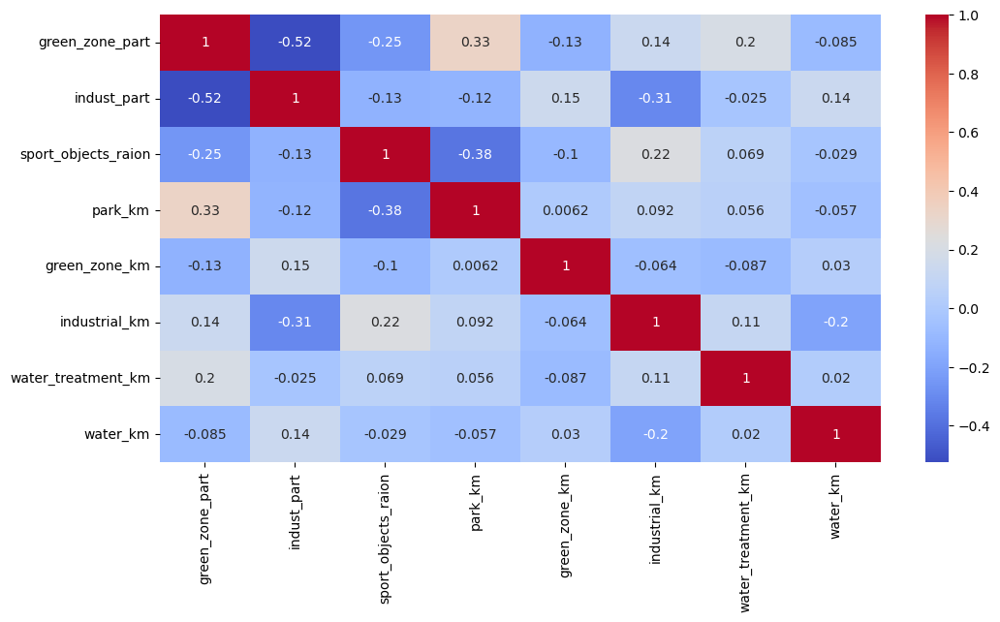

In [362]:
f, ax = plt.subplots(figsize=(12,6))

sns.heatmap(ecology.corr(), annot=True, cmap='coolwarm')

In [363]:
df.drop(columns=ecology_cols,axis=1,inplace=True)

In [364]:
df = pd.concat([df, ecology], axis=1)
df = df.loc[:, ~df.columns.duplicated()]
df

,full_sq,life_sq,floor,max_floor,material,num_room,kitch_sq,state,product_type,sub_area,...,build_count_monolith,build_count_panel,green_zone_part,indust_part,sport_objects_raion,park_km,green_zone_km,industrial_km,water_treatment_km,water_km
0,43.00,27.0,4.0,12.0,1.0,2.0,6.0,2.0,Investment,Bibirevo,...,2.0,184.0,0.189727,0.000070,7,2.158587,0.600973,1.080934,23.683460,0.992631
1,34.00,19.0,3.0,12.0,1.0,2.0,6.0,2.0,Investment,Nagatinskij Zaton,...,4.0,90.0,0.372602,0.049637,6,0.550690,0.065321,0.966479,1.317476,0.698081
2,43.00,29.0,2.0,12.0,1.0,2.0,6.0,2.0,Investment,Tekstil'shhiki,...,4.0,60.0,0.112560,0.118537,5,0.374848,0.453172,0.939275,4.912660,0.468265
3,89.00,50.0,9.0,12.0,1.0,2.0,6.0,2.0,Investment,Mitino,...,50.0,201.0,0.194703,0.069753,17,0.078090,0.106125,0.451173,15.623710,1.200336
4,77.00,77.0,4.0,12.0,1.0,2.0,6.0,2.0,Investment,Basmannoe,...,16.0,35.0,0.015234,0.037316,25,0.258289,0.236214,0.392871,10.683540,0.820294
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38128,52.20,31.8,10.0,12.0,5.0,2.0,9.1,2.0,Investment,Kon'kovo,...,3.0,260.0,0.127002,0.135650,11,2.985011,0.199909,0.624466,8.841655,0.219356
38129,54.09,30.0,14.0,0.0,1.0,2.0,0.0,2.0,OwnerOccupier,Poselenie Desjonovskoe,...,6.0,92.0,0.349935,0.011654,0,9.684197,0.991824,1.351922,9.211348,0.215268
38130,41.08,1.0,12.0,1.0,1.0,1.0,1.0,1.0,OwnerOccupier,Tverskoe,...,25.0,41.0,0.065444,0.000078,29,0.284300,0.189089,2.640803,10.378040,0.524839
38131,34.80,19.8,8.0,9.0,5.0,1.0,6.4,2.0,Investment,Orehovo-Borisovo Juzhnoe,...,3.0,164.0,0.075790,0.100456,7,2.950264,0.766444,0.521349,5.611768,1.394677


## Exploration

In [365]:
corr_matrix = df.corr()

<AxesSubplot:>

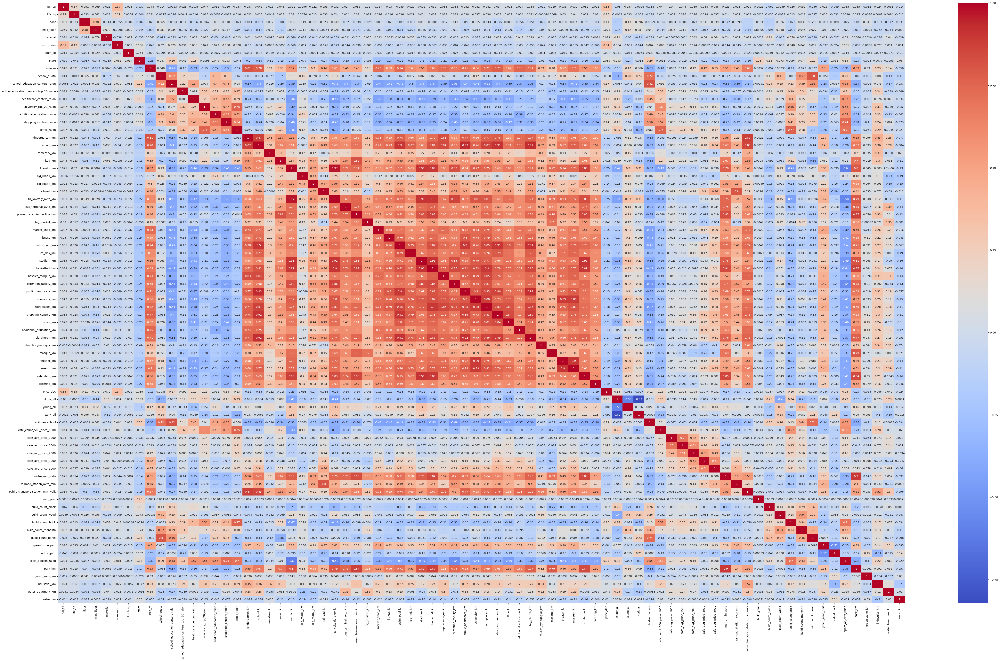

In [206]:
f, ax = plt.subplots(figsize=(70,40))

sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')

In [209]:
choose_columns_with_high_corr(corr_matrix, 0.88)

{('zd_vokzaly_avto_km', 'kremlin_km'): 0.9657739323384571,
 ('swim_pool_km', 'school_km'): 0.902654141569172,
 ('stadium_km', 'kremlin_km'): 0.9058245460422197,
 ('stadium_km', 'zd_vokzaly_avto_km'): 0.90528615283079,
 ('basketball_km', 'kremlin_km'): 0.8932820420881483,
 ('basketball_km', 'zd_vokzaly_avto_km'): 0.9048094776592642,
 ('basketball_km', 'stadium_km'): 0.909157620815499,
 ('public_healthcare_km', 'school_km'): 0.9300741413415982,
 ('public_healthcare_km', 'swim_pool_km'): 0.8965560861017858,
 ('workplaces_km', 'basketball_km'): 0.895751265496547,
 ('workplaces_km', 'university_km'): 0.8801945695189854,
 ('shopping_centers_km', 'school_km'): 0.9116099495026733,
 ('shopping_centers_km', 'swim_pool_km'): 0.9071782241413211,
 ('big_church_km', 'school_km'): 0.9242663713839956,
 ('big_church_km', 'swim_pool_km'): 0.910602811855252,
 ('big_church_km', 'public_healthcare_km'): 0.915978619785369,
 ('big_church_km', 'shopping_centers_km'): 0.8863519247989352,
 ('theater_km', 'unive

## Drop low correlated features with target

In [366]:
price = abs(corr_matrix['price_doc']) 
price

full_sq               0.330426
life_sq               0.151385
floor                 0.105738
max_floor             0.073018
material              0.071726
                        ...   
park_km               0.168908
green_zone_km         0.055136
industrial_km         0.045557
water_treatment_km    0.048836
water_km              0.024005
Name: price_doc, Length: 77, dtype: float64

In [367]:
price.describe()

count    77.000000
mean      0.135704
std       0.122322
min       0.002334
25%       0.081401
50%       0.128924
75%       0.170775
max       1.000000
Name: price_doc, dtype: float64

In [368]:
df.drop(columns=price[price < 0.02].index,axis=1,inplace=True)

## Exploration

In [369]:
corr_matrix = df.corr()

<AxesSubplot:>

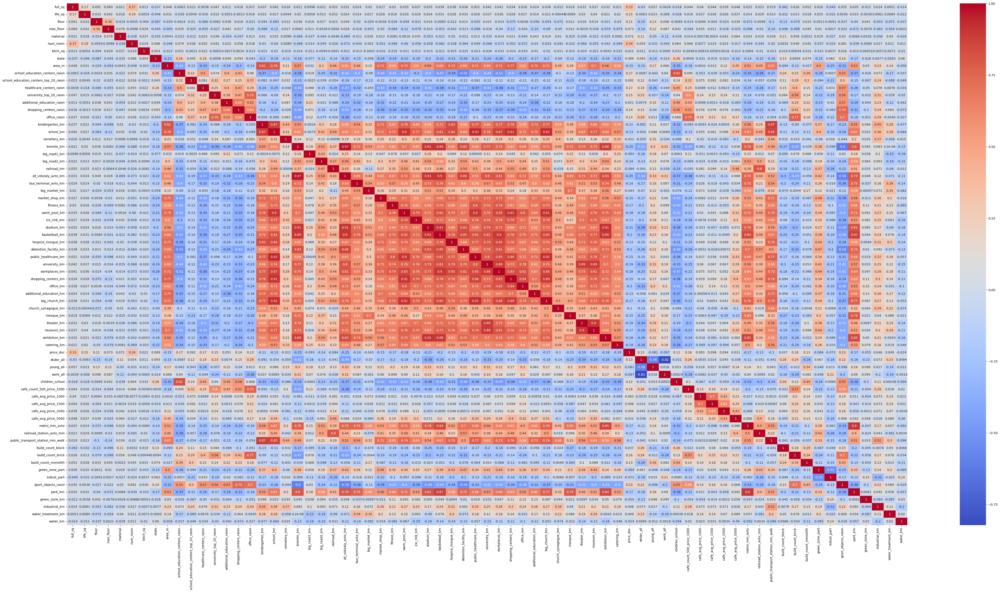

In [370]:
f, ax = plt.subplots(figsize=(60,30))

sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')

In [371]:
choose_columns_with_high_corr(corr_matrix, 0.88)

{('zd_vokzaly_avto_km', 'kremlin_km'): 0.9657739323384571,
 ('swim_pool_km', 'school_km'): 0.902654141569172,
 ('stadium_km', 'kremlin_km'): 0.9058245460422197,
 ('stadium_km', 'zd_vokzaly_avto_km'): 0.90528615283079,
 ('basketball_km', 'kremlin_km'): 0.8932820420881483,
 ('basketball_km', 'zd_vokzaly_avto_km'): 0.9048094776592642,
 ('basketball_km', 'stadium_km'): 0.909157620815499,
 ('public_healthcare_km', 'school_km'): 0.9300741413415982,
 ('public_healthcare_km', 'swim_pool_km'): 0.8965560861017858,
 ('workplaces_km', 'basketball_km'): 0.895751265496547,
 ('workplaces_km', 'university_km'): 0.8801945695189854,
 ('shopping_centers_km', 'school_km'): 0.9116099495026733,
 ('shopping_centers_km', 'swim_pool_km'): 0.9071782241413211,
 ('big_church_km', 'school_km'): 0.9242663713839956,
 ('big_church_km', 'swim_pool_km'): 0.910602811855252,
 ('big_church_km', 'public_healthcare_km'): 0.915978619785369,
 ('big_church_km', 'shopping_centers_km'): 0.8863519247989352,
 ('theater_km', 'unive

## Sport

In [373]:
sport_cols = df.columns[df.columns.str.contains('(stadium|basketball|pool|fitness|rink)')]

C:\Users\User\AppData\Local\Temp\ipykernel_17208\3757497466.py:1: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  sport_cols = df.columns[df.columns.str.contains('(stadium|basketball|pool|fitness|rink)')]


In [374]:
sport = df[sport_cols]
sport

,fitness_km,swim_pool_km,ice_rink_km,stadium_km,basketball_km
0,0.485841,3.065047,1.107594,8.148591,3.516513
1,0.668364,2.000154,8.972823,6.127073,1.161579
2,0.733101,1.239304,1.978517,0.767569,1.952771
3,0.623484,1.950317,6.483172,7.385521,4.923843
4,0.220288,2.544696,3.975401,3.610754,0.307915
...,...,...,...,...,...
38128,0.374664,1.486279,2.568154,3.314345,4.180481
38129,5.980372,15.850078,16.387081,19.746806,15.523658
38130,0.269716,1.421099,0.501856,4.018205,1.171506
38131,0.542683,1.277750,1.116351,6.449755,3.994409


<AxesSubplot:>

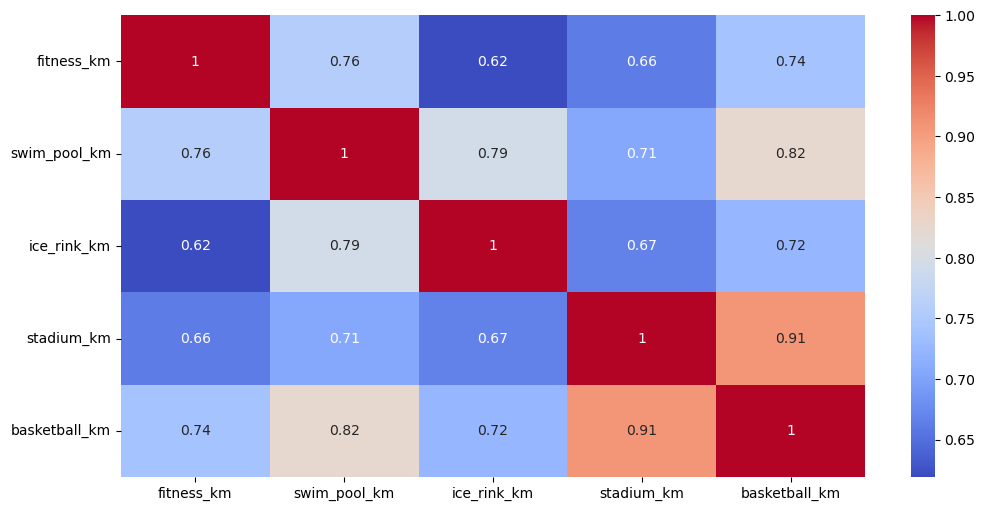

In [245]:
f, ax = plt.subplots(figsize=(12,6))

sns.heatmap(sport.corr(), annot=True, cmap='coolwarm')

In [375]:
sport['sport_km'] = 0 

for col in sport.columns:
    if col != 'sport_km':
        sport['sport_km'] += sport[col]
    
sport['sport_km'] /= (len(sport.columns)-1)

In [376]:
sport

,fitness_km,swim_pool_km,ice_rink_km,stadium_km,basketball_km,sport_km
0,0.485841,3.065047,1.107594,8.148591,3.516513,3.264717
1,0.668364,2.000154,8.972823,6.127073,1.161579,3.785998
2,0.733101,1.239304,1.978517,0.767569,1.952771,1.334252
3,0.623484,1.950317,6.483172,7.385521,4.923843,4.273267
4,0.220288,2.544696,3.975401,3.610754,0.307915,2.131811
...,...,...,...,...,...,...
38128,0.374664,1.486279,2.568154,3.314345,4.180481,2.384784
38129,5.980372,15.850078,16.387081,19.746806,15.523658,14.697599
38130,0.269716,1.421099,0.501856,4.018205,1.171506,1.476477
38131,0.542683,1.277750,1.116351,6.449755,3.994409,2.676189


In [377]:
sport.drop(columns=sport_cols, axis=1,inplace = True)

In [378]:
sport

,sport_km
0,3.264717
1,3.785998
2,1.334252
3,4.273267
4,2.131811
...,...
38128,2.384784
38129,14.697599
38130,1.476477
38131,2.676189


In [379]:
df.drop(columns=sport_cols,axis=1,inplace=True)

In [380]:
df = pd.concat([df, sport], axis=1)
df = df.loc[:, ~df.columns.duplicated()]
df

,full_sq,life_sq,floor,max_floor,material,num_room,kitch_sq,state,product_type,sub_area,...,build_count_monolith,green_zone_part,indust_part,sport_objects_raion,park_km,green_zone_km,industrial_km,water_treatment_km,water_km,sport_km
0,43.00,27.0,4.0,12.0,1.0,2.0,6.0,2.0,Investment,Bibirevo,...,2.0,0.189727,0.000070,7,2.158587,0.600973,1.080934,23.683460,0.992631,3.264717
1,34.00,19.0,3.0,12.0,1.0,2.0,6.0,2.0,Investment,Nagatinskij Zaton,...,4.0,0.372602,0.049637,6,0.550690,0.065321,0.966479,1.317476,0.698081,3.785998
2,43.00,29.0,2.0,12.0,1.0,2.0,6.0,2.0,Investment,Tekstil'shhiki,...,4.0,0.112560,0.118537,5,0.374848,0.453172,0.939275,4.912660,0.468265,1.334252
3,89.00,50.0,9.0,12.0,1.0,2.0,6.0,2.0,Investment,Mitino,...,50.0,0.194703,0.069753,17,0.078090,0.106125,0.451173,15.623710,1.200336,4.273267
4,77.00,77.0,4.0,12.0,1.0,2.0,6.0,2.0,Investment,Basmannoe,...,16.0,0.015234,0.037316,25,0.258289,0.236214,0.392871,10.683540,0.820294,2.131811
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38128,52.20,31.8,10.0,12.0,5.0,2.0,9.1,2.0,Investment,Kon'kovo,...,3.0,0.127002,0.135650,11,2.985011,0.199909,0.624466,8.841655,0.219356,2.384784
38129,54.09,30.0,14.0,0.0,1.0,2.0,0.0,2.0,OwnerOccupier,Poselenie Desjonovskoe,...,6.0,0.349935,0.011654,0,9.684197,0.991824,1.351922,9.211348,0.215268,14.697599
38130,41.08,1.0,12.0,1.0,1.0,1.0,1.0,1.0,OwnerOccupier,Tverskoe,...,25.0,0.065444,0.000078,29,0.284300,0.189089,2.640803,10.378040,0.524839,1.476477
38131,34.80,19.8,8.0,9.0,5.0,1.0,6.4,2.0,Investment,Orehovo-Borisovo Juzhnoe,...,3.0,0.075790,0.100456,7,2.950264,0.766444,0.521349,5.611768,1.394677,2.676189


## Exploration

In [381]:
corr_matrix = df.corr()

<AxesSubplot:>

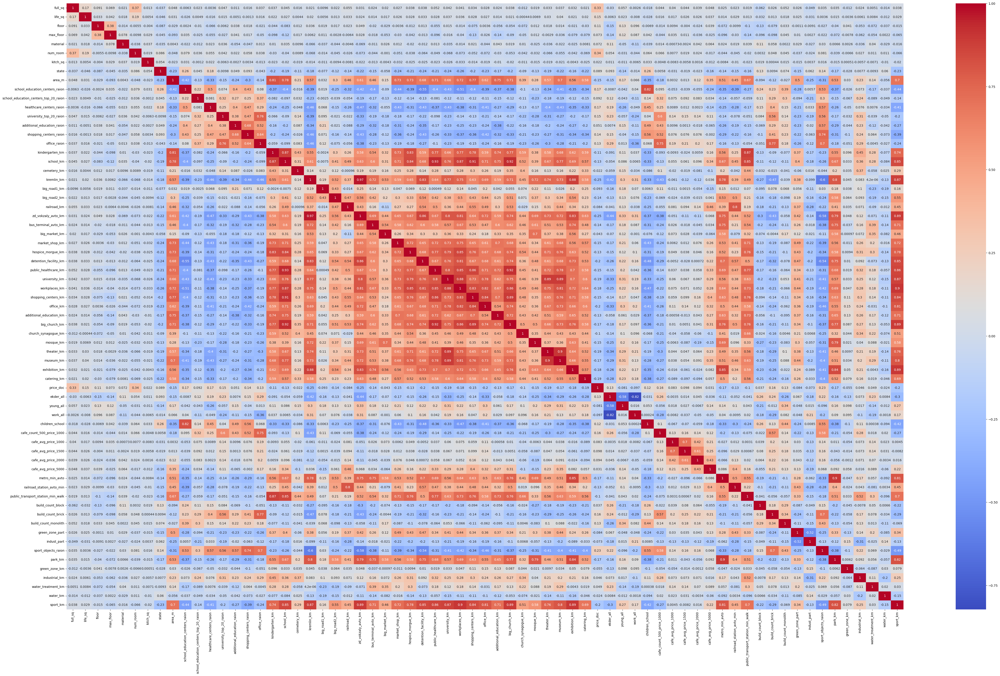

In [382]:
f, ax = plt.subplots(figsize=(60,35))

sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')

In [383]:
choose_columns_with_high_corr(corr_matrix, 0.85)

{('school_km', 'kindergarten_km'): 0.8730549405062743,
 ('zd_vokzaly_avto_km', 'kremlin_km'): 0.9657739323384571,
 ('detention_facility_km', 'zd_vokzaly_avto_km'): 0.8641808470368509,
 ('public_healthcare_km', 'school_km'): 0.9300741413415982,
 ('workplaces_km', 'school_km'): 0.8688826855085449,
 ('workplaces_km', 'hospice_morgue_km'): 0.8508180219878911,
 ('workplaces_km', 'university_km'): 0.8801945695189854,
 ('shopping_centers_km', 'school_km'): 0.9116099495026733,
 ('shopping_centers_km', 'public_healthcare_km'): 0.8638697310162906,
 ('big_church_km', 'school_km'): 0.9242663713839956,
 ('big_church_km', 'public_healthcare_km'): 0.915978619785369,
 ('big_church_km', 'workplaces_km'): 0.8604168520679595,
 ('big_church_km', 'shopping_centers_km'): 0.8863519247989352,
 ('theater_km', 'university_km'): 0.8881548446619308,
 ('museum_km', 'university_km'): 0.889988490082883,
 ('museum_km', 'theater_km'): 0.9023053687886688,
 ('exhibition_km', 'kremlin_km'): 0.8757342308974597,
 ('metro_m

## Education

In [402]:
education_col = df.columns[df.columns.str.contains('(school_km|sport_objects|university|education|kindergarten)')]
education_col

C:\Users\User\AppData\Local\Temp\ipykernel_17208\3880515616.py:1: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  education_col = df.columns[df.columns.str.contains('(school_km|sport_objects|university|education|kindergarten)')]


Index(['school_education_centers_raion',
       'school_education_centers_top_20_raion', 'university_top_20_raion',
       'additional_education_raion', 'kindergarten_km', 'school_km',
       'university_km', 'additional_education_km', 'sport_objects_raion'],
      dtype='object')

In [403]:
education = df[education_col]
education

,school_education_centers_raion,school_education_centers_top_20_raion,university_top_20_raion,additional_education_raion,kindergarten_km,school_km,university_km,additional_education_km,sport_objects_raion
0,5,0,0,3,0.145700,0.177975,6.715026,0.947962,7
1,8,0,0,1,0.147754,0.273345,1.852560,1.072315,6
2,7,0,0,1,0.049102,0.158072,0.841254,0.391957,5
3,10,0,0,6,0.179441,0.236455,10.903161,0.892674,17
4,9,0,2,2,0.247901,0.376838,0.991683,0.810801,25
...,...,...,...,...,...,...,...,...,...
38128,5,0,0,3,0.334653,0.413881,1.144428,0.953901,11
38129,0,0,0,1,4.415205,7.671322,16.569250,3.978097,0
38130,4,1,2,16,1.048962,0.269716,2.180440,0.000000,29
38131,7,1,0,2,0.073023,0.208540,3.679888,0.676312,7


<AxesSubplot:>

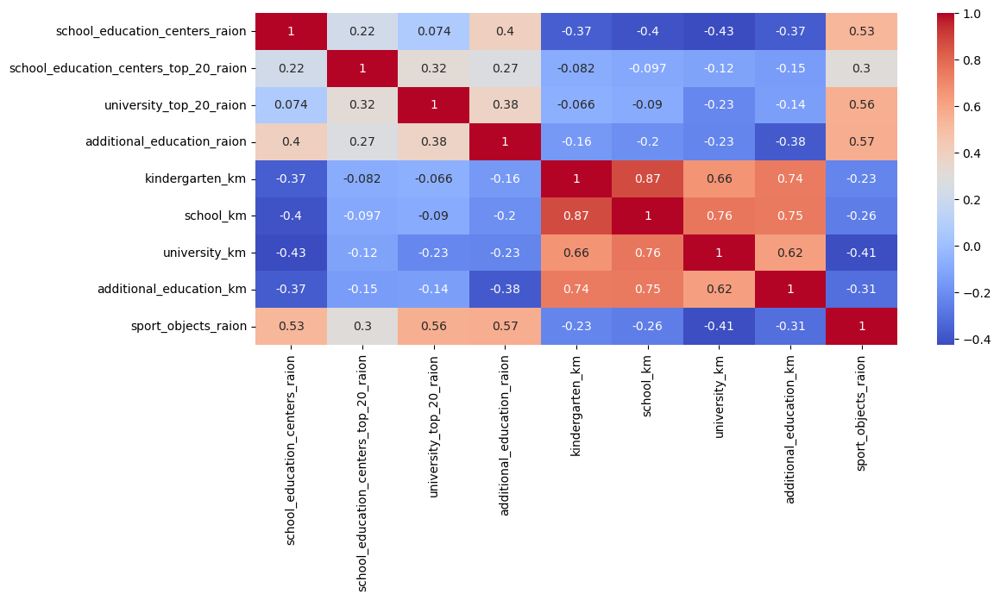

In [398]:
f, ax = plt.subplots(figsize=(12,5))

sns.heatmap(education.corr(), annot=True, cmap='coolwarm')

In [405]:
raion_edu = education.columns[education.columns.str.contains('raion')]
km_edu = education.columns[education.columns.str.contains('km')]

In [406]:
def group_cols_by_mean(df, columns, name_col):
    df[name_col] = 0 
    
    for col in columns:
        df[name_col] += df[col]
    
    df[name_col] /= len(columns)
    df.drop(columns=columns, axis=1,inplace=True)

In [407]:
group_cols_by_mean(education, raion_edu, 'education_raion')
group_cols_by_mean(education, km_edu, 'education_km')

<AxesSubplot:>

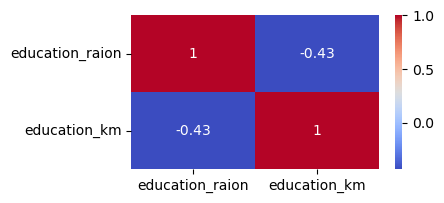

In [410]:
f, ax = plt.subplots(figsize=(4,2))

sns.heatmap(education.corr(), annot=True, cmap='coolwarm')

In [411]:
df.drop(columns=education_col,axis=1,inplace=True)

In [412]:
df = pd.concat([df, education], axis=1)
df = df.loc[:, ~df.columns.duplicated()]
df

,full_sq,life_sq,floor,max_floor,material,num_room,kitch_sq,state,product_type,sub_area,...,green_zone_part,indust_part,park_km,green_zone_km,industrial_km,water_treatment_km,water_km,sport_km,education_raion,education_km
0,43.00,27.0,4.0,12.0,1.0,2.0,6.0,2.0,Investment,Bibirevo,...,0.189727,0.000070,2.158587,0.600973,1.080934,23.683460,0.992631,3.264717,3.0,1.996666
1,34.00,19.0,3.0,12.0,1.0,2.0,6.0,2.0,Investment,Nagatinskij Zaton,...,0.372602,0.049637,0.550690,0.065321,0.966479,1.317476,0.698081,3.785998,3.0,0.836494
2,43.00,29.0,2.0,12.0,1.0,2.0,6.0,2.0,Investment,Tekstil'shhiki,...,0.112560,0.118537,0.374848,0.453172,0.939275,4.912660,0.468265,1.334252,2.6,0.360096
3,89.00,50.0,9.0,12.0,1.0,2.0,6.0,2.0,Investment,Mitino,...,0.194703,0.069753,0.078090,0.106125,0.451173,15.623710,1.200336,4.273267,6.6,3.052933
4,77.00,77.0,4.0,12.0,1.0,2.0,6.0,2.0,Investment,Basmannoe,...,0.015234,0.037316,0.258289,0.236214,0.392871,10.683540,0.820294,2.131811,7.6,0.606806
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38128,52.20,31.8,10.0,12.0,5.0,2.0,9.1,2.0,Investment,Kon'kovo,...,0.127002,0.135650,2.985011,0.199909,0.624466,8.841655,0.219356,2.384784,3.8,0.711716
38129,54.09,30.0,14.0,0.0,1.0,2.0,0.0,2.0,OwnerOccupier,Poselenie Desjonovskoe,...,0.349935,0.011654,9.684197,0.991824,1.351922,9.211348,0.215268,14.697599,0.2,8.158468
38130,41.08,1.0,12.0,1.0,1.0,1.0,1.0,1.0,OwnerOccupier,Tverskoe,...,0.065444,0.000078,0.284300,0.189089,2.640803,10.378040,0.524839,1.476477,10.4,0.874779
38131,34.80,19.8,8.0,9.0,5.0,1.0,6.4,2.0,Investment,Orehovo-Borisovo Juzhnoe,...,0.075790,0.100456,2.950264,0.766444,0.521349,5.611768,1.394677,2.676189,3.4,1.159441


## Exploration

In [414]:
corr_matrix = df.corr()

<AxesSubplot:>

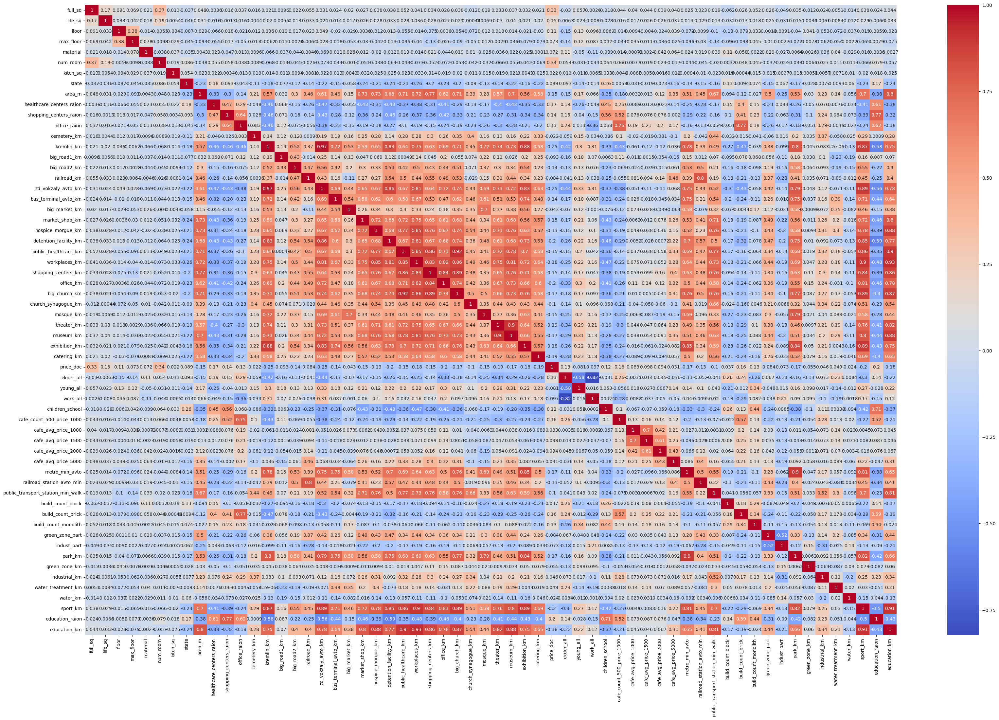

In [416]:
f, ax = plt.subplots(figsize=(40,25))

sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')

In [431]:
choose_columns_with_high_corr(corr_matrix, 0.9)

{('zd_vokzaly_avto_km', 'kremlin_km'): 0.9657739323384571,
 ('big_church_km', 'public_healthcare_km'): 0.915978619785369,
 ('museum_km', 'theater_km'): 0.9023053687886688,
 ('sport_km', 'workplaces_km'): 0.9006802408405223,
 ('education_km', 'public_healthcare_km'): 0.9031480571925145,
 ('education_km', 'workplaces_km'): 0.9254980974416799,
 ('education_km', 'sport_km'): 0.9115952211720625}

In [430]:
corr_matrix['kremlin_km'][corr_matrix['kremlin_km'] > 0.7].shape[0] > \
corr_matrix['zd_vokzaly_avto_km'][corr_matrix['zd_vokzaly_avto_km'] > 0.7].shape[0]

True

Drop kremlin_km

In [432]:
df.drop('kremlin_km', axis=1,inplace=True)

<AxesSubplot:>

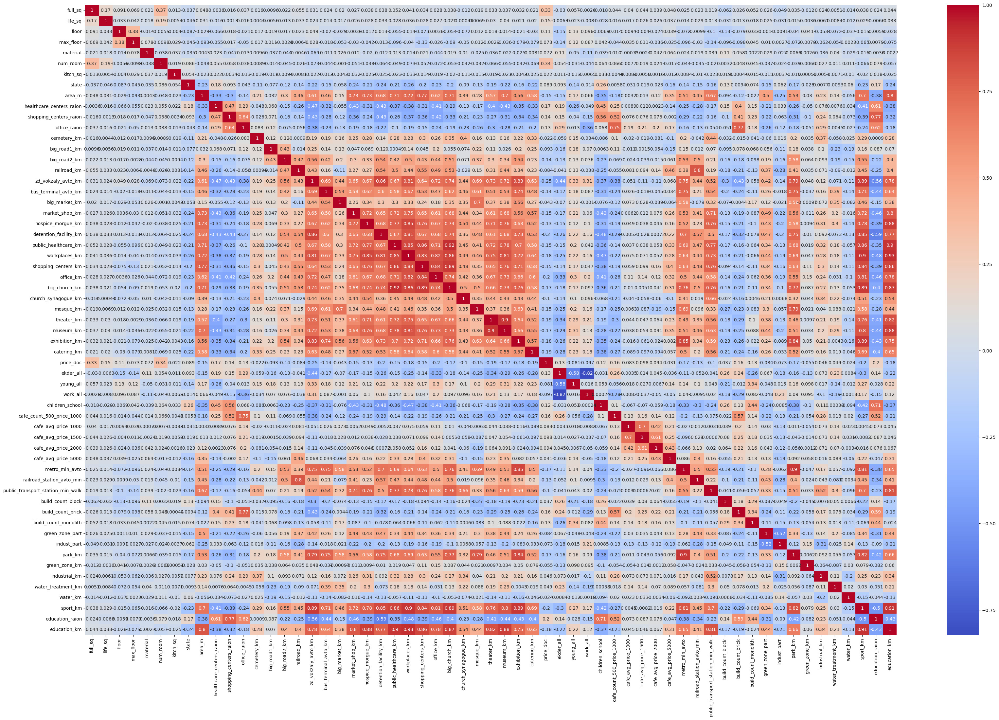

In [434]:
f, ax = plt.subplots(figsize=(40,25))

sns.heatmap(df.corr(), annot=True, cmap='coolwarm')

## Group km columns

In [447]:
km_columns = df.columns[df.columns.str.contains('km')]
km_columns

Index(['cemetery_km', 'big_road1_km', 'big_road2_km', 'railroad_km',
       'zd_vokzaly_avto_km', 'bus_terminal_avto_km', 'big_market_km',
       'market_shop_km', 'hospice_morgue_km', 'detention_facility_km',
       'public_healthcare_km', 'workplaces_km', 'shopping_centers_km',
       'office_km', 'big_church_km', 'church_synagogue_km', 'mosque_km',
       'theater_km', 'museum_km', 'exhibition_km', 'catering_km', 'park_km',
       'green_zone_km', 'industrial_km', 'water_treatment_km', 'water_km',
       'sport_km', 'education_km'],
      dtype='object')

In [448]:
km = df[km_columns]
km

,cemetery_km,big_road1_km,big_road2_km,railroad_km,zd_vokzaly_avto_km,bus_terminal_avto_km,big_market_km,market_shop_km,hospice_morgue_km,detention_facility_km,...,museum_km,exhibition_km,catering_km,park_km,green_zone_km,industrial_km,water_treatment_km,water_km,sport_km,education_km
0,1.804127,1.422391,3.830951,1.305159,14.231961,24.292406,10.814172,1.676258,2.392353,4.248036,...,7.389498,7.023705,0.516838,2.158587,0.600973,1.080934,23.683460,0.992631,3.264717,1.996666
1,4.655004,2.887377,3.103996,0.694536,9.242586,5.706113,6.910568,3.424716,2.543747,12.649879,...,0.709260,2.358840,0.230287,0.550690,0.065321,0.966479,1.317476,0.698081,3.785998,0.836494
2,3.381083,0.647250,2.927487,0.700691,9.540544,6.710302,5.752368,1.375443,0.621357,7.682303,...,3.156423,4.958214,0.190462,0.374848,0.453172,0.939275,4.912660,0.468265,1.334252,0.360096
3,2.017080,2.677824,2.780449,1.999265,17.478380,6.734618,27.892717,0.811275,3.549558,8.789894,...,16.041521,5.029696,0.465820,0.078090,0.106125,0.451173,15.623710,1.200336,4.273267,3.052933
4,2.936581,1.721834,3.133531,0.084113,1.595898,1.423428,9.155057,1.969738,1.864637,3.779781,...,1.800125,1.339652,0.026102,0.258289,0.236214,0.392871,10.683540,0.820294,2.131811,0.606806
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38128,4.452060,3.042145,4.284690,5.337760,13.988172,5.396140,2.453438,0.457083,2.264219,18.732684,...,5.702702,0.948545,0.199910,2.985011,0.199909,0.624466,8.841655,0.219356,2.384784,0.711716
38129,1.252875,0.464679,9.152001,8.607590,30.195354,15.166222,11.910442,7.480514,4.092890,37.115402,...,18.104218,14.248256,0.046830,9.684197,0.991824,1.351922,9.211348,0.215268,14.697599,8.158468
38130,4.242627,4.081283,4.273395,2.566044,4.060430,3.983721,7.836658,1.092897,0.615658,3.939382,...,0.695251,1.184340,0.107759,0.284300,0.189089,2.640803,10.378040,0.524839,1.476477,0.874779
38131,1.856325,1.425847,1.425847,2.461916,17.433375,2.160649,0.885412,1.280650,2.596009,4.655112,...,3.127103,3.618234,0.322872,2.950264,0.766444,0.521349,5.611768,1.394677,2.676189,1.159441


<AxesSubplot:>

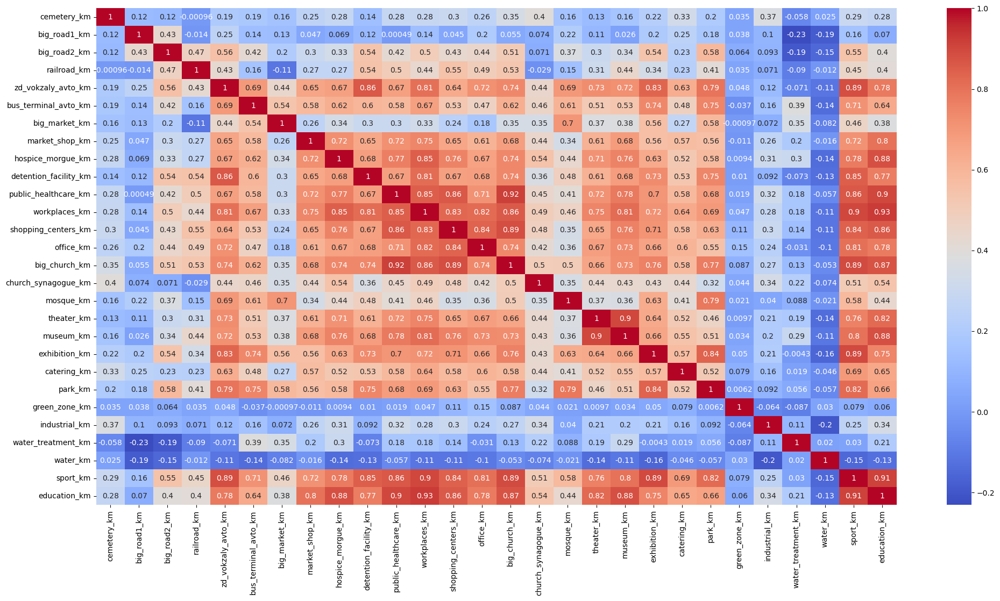

In [440]:
f, ax = plt.subplots(figsize=(24,12))

sns.heatmap(km.corr(), annot=True, cmap='coolwarm')

Drop not correlated columns

In [449]:
drop_columns = km.columns[km.columns.str.contains('(road|cemetery|green_zone|industrial|water|big_market)')]
drop_columns

C:\Users\User\AppData\Local\Temp\ipykernel_17208\749567667.py:1: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  drop_columns = km.columns[km.columns.str.contains('(road|cemetery|green_zone|industrial|water|big_market)')]


Index(['cemetery_km', 'big_road1_km', 'big_road2_km', 'railroad_km',
       'big_market_km', 'green_zone_km', 'industrial_km', 'water_treatment_km',
       'water_km'],
      dtype='object')

In [450]:
km.drop(columns=drop_columns, axis=1, inplace=True)

<AxesSubplot:>

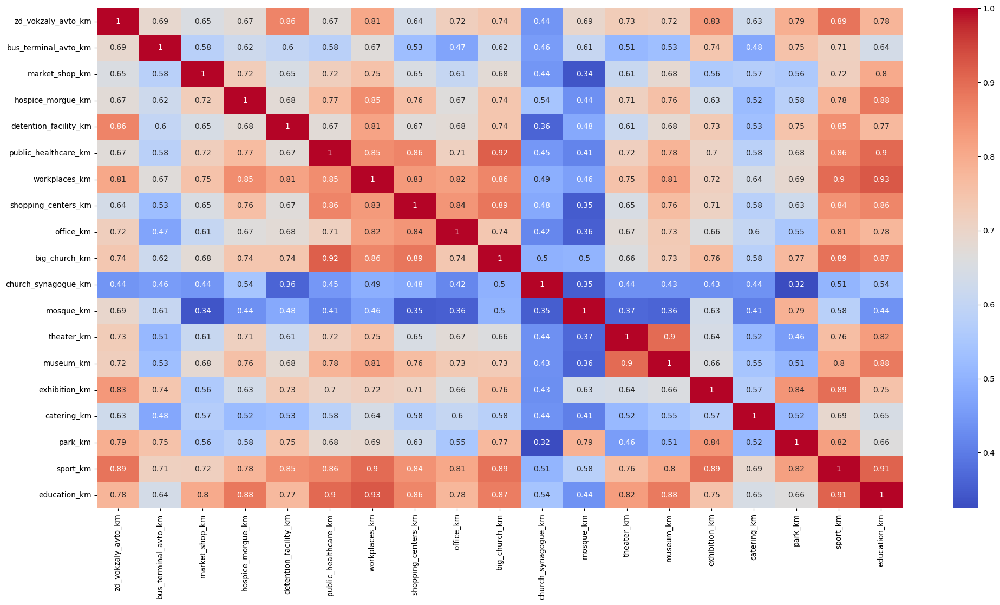

In [451]:
f, ax = plt.subplots(figsize=(24,12))

sns.heatmap(km.corr(), annot=True, cmap='coolwarm')

In [452]:
columns_for_df = km.columns
columns_for_df

Index(['zd_vokzaly_avto_km', 'bus_terminal_avto_km', 'market_shop_km',
       'hospice_morgue_km', 'detention_facility_km', 'public_healthcare_km',
       'workplaces_km', 'shopping_centers_km', 'office_km', 'big_church_km',
       'church_synagogue_km', 'mosque_km', 'theater_km', 'museum_km',
       'exhibition_km', 'catering_km', 'park_km', 'sport_km', 'education_km'],
      dtype='object')

In [454]:
church_cols = km.columns[km.columns.str.contains('(church|mosque)')]
church_cols

C:\Users\User\AppData\Local\Temp\ipykernel_17208\4231135294.py:1: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  church_cols = km.columns[km.columns.str.contains('(church|mosque)')]


Index(['big_church_km', 'church_synagogue_km', 'mosque_km'], dtype='object')

In [455]:
group_cols_by_mean(km, church_cols, "church_km")

<AxesSubplot:>

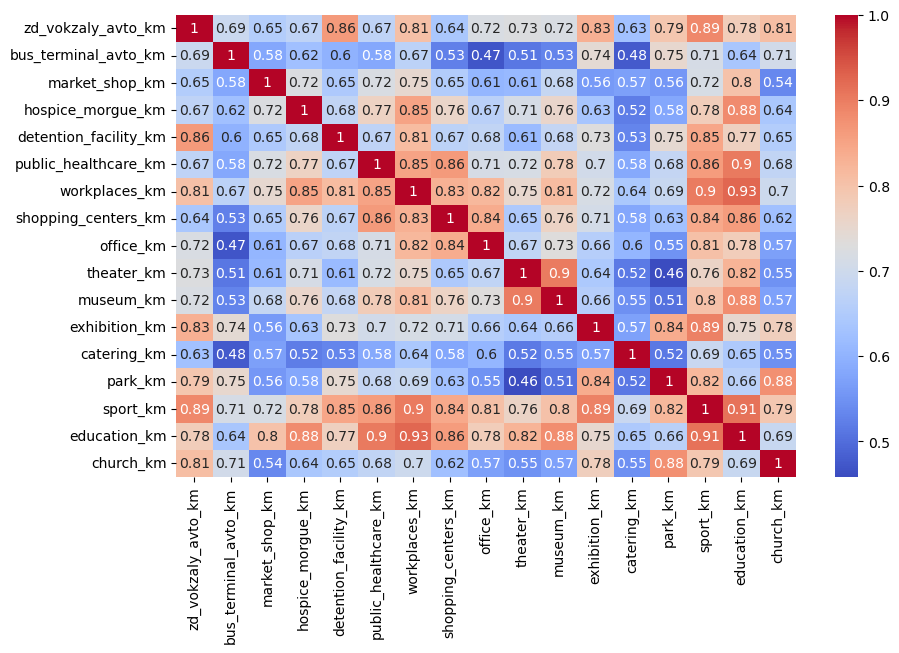

In [465]:
f, ax = plt.subplots(figsize=(10,6))

sns.heatmap(km.corr(), annot=True, cmap='coolwarm')

In [468]:
km.columns[:-1]

Index(['zd_vokzaly_avto_km', 'bus_terminal_avto_km', 'market_shop_km',
       'hospice_morgue_km', 'detention_facility_km', 'public_healthcare_km',
       'workplaces_km', 'shopping_centers_km', 'office_km', 'theater_km',
       'museum_km', 'exhibition_km', 'catering_km', 'park_km', 'sport_km',
       'education_km'],
      dtype='object')

In [473]:
cor = km.corr()

In [488]:
cnt_corr = {}

for col in km.columns:
    cnt_corr[col] =  cor[col][(abs(cor[col]) > 0.7) & (abs(cor[col]) < 1)].shape[0]

In [491]:
cnt_corr = dict(sorted(cnt_corr.items(), key=lambda item: item[1], reverse=True))
cnt_corr

{'sport_km': 15,
 'workplaces_km': 12,
 'education_km': 12,
 'zd_vokzaly_avto_km': 10,
 'public_healthcare_km': 10,
 'exhibition_km': 10,
 'museum_km': 9,
 'hospice_morgue_km': 8,
 'shopping_centers_km': 8,
 'office_km': 7,
 'theater_km': 7,
 'detention_facility_km': 6,
 'park_km': 6,
 'market_shop_km': 5,
 'church_km': 5,
 'bus_terminal_avto_km': 4,
 'catering_km': 0}

In [496]:
columns_group = []
for k, v in cnt_corr.items():
    if v < 8:
        break
    else:
        columns_group.append(k)
        
columns_group        

['sport_km',
 'workplaces_km',
 'education_km',
 'zd_vokzaly_avto_km',
 'public_healthcare_km',
 'exhibition_km',
 'museum_km',
 'hospice_morgue_km',
 'shopping_centers_km']

In [497]:
group_cols_by_mean(km, columns_group, "places_km")

<AxesSubplot:>

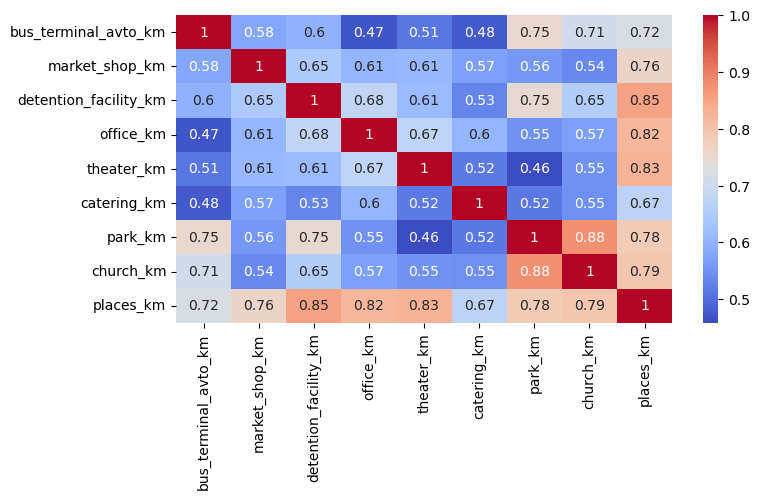

In [498]:
f, ax = plt.subplots(figsize=(8,4))

sns.heatmap(km.corr(), annot=True, cmap='coolwarm')

In [500]:
group_cols_by_mean(km, ["detention_facility_km", "theater_km", "office_km", "park_km", "places_km"], "all_places_km")

<AxesSubplot:>

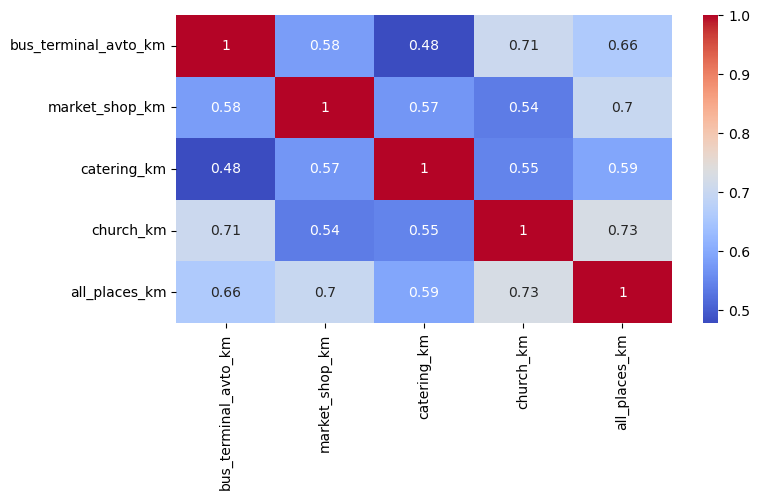

In [501]:
f, ax = plt.subplots(figsize=(8,4))

sns.heatmap(km.corr(), annot=True, cmap='coolwarm')

In [503]:
df.drop(columns=columns_for_df, axis=1,inplace=True)

In [504]:
df = pd.concat([df, km], axis=1)
df = df.loc[:, ~df.columns.duplicated()]
df

,full_sq,life_sq,floor,max_floor,material,num_room,kitch_sq,state,product_type,sub_area,...,green_zone_km,industrial_km,water_treatment_km,water_km,education_raion,bus_terminal_avto_km,market_shop_km,catering_km,church_km,all_places_km
0,43.00,27.0,4.0,12.0,1.0,2.0,6.0,2.0,Investment,Bibirevo,...,0.600973,1.080934,23.683460,0.992631,3.0,24.292406,1.676258,0.516838,1.728670,5.068979
1,34.00,19.0,3.0,12.0,1.0,2.0,6.0,2.0,Investment,Nagatinskij Zaton,...,0.065321,0.966479,1.317476,0.698081,3.0,5.706113,3.424716,0.230287,2.093604,6.673826
2,43.00,29.0,2.0,12.0,1.0,2.0,6.0,2.0,Investment,Tekstil'shhiki,...,0.453172,0.939275,4.912660,0.468265,2.6,6.710302,1.375443,0.190462,3.952283,4.311141
3,89.00,50.0,9.0,12.0,1.0,2.0,6.0,2.0,Investment,Mitino,...,0.106125,0.451173,15.623710,1.200336,6.6,6.734618,0.811275,0.465820,5.964577,7.116566
4,77.00,77.0,4.0,12.0,1.0,2.0,6.0,2.0,Investment,Basmannoe,...,0.236214,0.392871,10.683540,0.820294,7.6,1.423428,1.969738,0.026102,1.028269,1.801648
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38128,52.20,31.8,10.0,12.0,5.0,2.0,9.1,2.0,Investment,Kon'kovo,...,0.199909,0.624466,8.841655,0.219356,3.8,5.396140,0.457083,0.199910,1.890519,9.097456
38129,54.09,30.0,14.0,0.0,1.0,2.0,0.0,2.0,OwnerOccupier,Poselenie Desjonovskoe,...,0.991824,1.351922,9.211348,0.215268,0.2,15.166222,7.480514,0.046830,6.847031,22.231960
38130,41.08,1.0,12.0,1.0,1.0,1.0,1.0,1.0,OwnerOccupier,Tverskoe,...,0.189089,2.640803,10.378040,0.524839,10.4,3.983721,1.092897,0.107759,0.731472,2.143128
38131,34.80,19.8,8.0,9.0,5.0,1.0,6.4,2.0,Investment,Orehovo-Borisovo Juzhnoe,...,0.766444,0.521349,5.611768,1.394677,3.4,2.160649,1.280650,0.322872,3.663394,5.258519


## Exploration

In [505]:
corr_matrix = df.corr()

<AxesSubplot:>

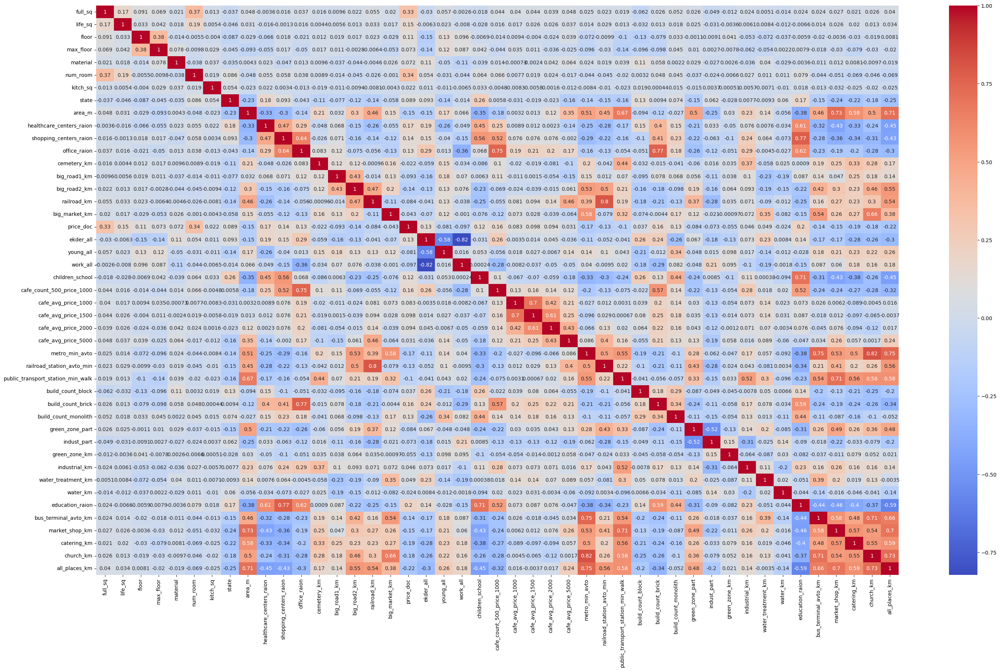

In [507]:
f, ax = plt.subplots(figsize=(35,20))

sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')

In [511]:
choose_columns_with_high_corr(corr_matrix, 0.7)

{('work_all', 'ekder_all'): -0.8224093835136744,
 ('cafe_count_500_price_1000', 'office_raion'): 0.7511345232020112,
 ('cafe_avg_price_1500', 'cafe_avg_price_1000'): 0.7041565259069518,
 ('railroad_station_avto_min', 'railroad_km'): 0.8016856414010247,
 ('build_count_brick', 'office_raion'): 0.7712303751760003,
 ('education_raion', 'shopping_centers_raion'): 0.7746408391413754,
 ('education_raion', 'children_school'): 0.7079978478930294,
 ('bus_terminal_avto_km', 'metro_min_avto'): 0.7478100121047079,
 ('market_shop_km', 'area_m'): 0.7261947208688094,
 ('market_shop_km', 'public_transport_station_min_walk'): 0.7104025224325375,
 ('church_km', 'metro_min_avto'): 0.8163338779559447,
 ('church_km', 'bus_terminal_avto_km'): 0.7055953734952904,
 ('all_places_km', 'area_m'): 0.7106553215126135,
 ('all_places_km', 'metro_min_avto'): 0.7460662847178209,
 ('all_places_km', 'church_km'): 0.7263506191056297}

In [518]:
price = abs(corr_matrix['price_doc'])
price.mean()

0.13747162888049103

In [519]:
price['ekder_all'] > price['work_all']

True

In [520]:
df.drop('work_all', axis=1,inplace=True)

In [521]:
price['railroad_station_avto_min'] > price['railroad_km']

True

In [522]:
df.drop('railroad_km', axis=1,inplace=True)

In [528]:
print(price['metro_min_avto'] > price['all_places_km'])
print(price['area_m'] > price['all_places_km'])
print(price['bus_terminal_avto_km'] > price['all_places_km'])

False
False
False


In [533]:
df.drop(columns=['metro_min_avto', 'area_m', 'bus_terminal_avto_km'], axis=1,inplace=True)

## Check correlation data

In [534]:
corr_matrix = df.corr()

<AxesSubplot:>

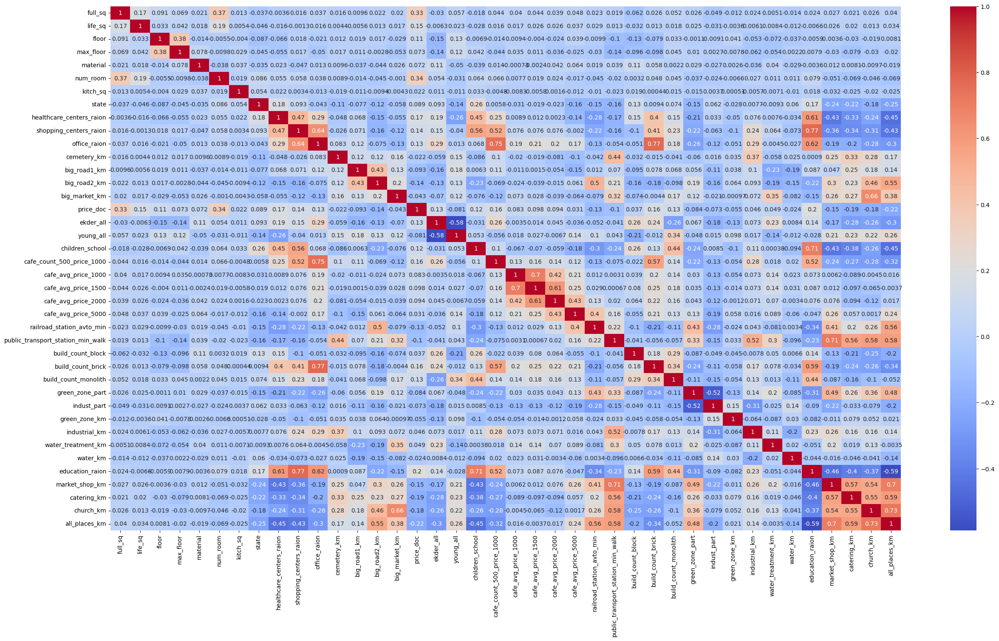

In [536]:
f, ax = plt.subplots(figsize=(30,16))

sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')

In [537]:
group_cols_by_mean(df, ["market_shop_km", "church_km", "all_places_km"], "places_km")

In [540]:
group_cols_by_mean(df, ["catering_km", "places_km"], "all_places_km")

In [541]:
corr_matrix = df.corr()

<AxesSubplot:>

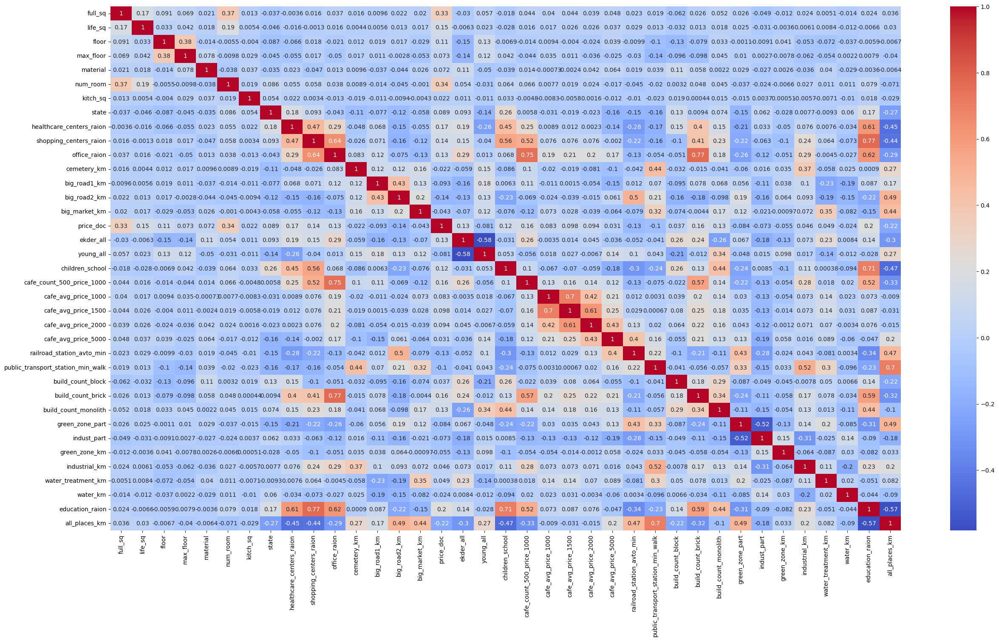

In [542]:
f, ax = plt.subplots(figsize=(30,16))

sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')

In [549]:
df.shape

(38133, 42)

In [550]:
df.to_csv('../4_step/sample3.csv', sep=';', index=False)